# Компьютерный практикум 2022-2023

## [Numpy](http://numpy.org/)

Модуль `Numpy` позволяет эффективно работать с n-мерными массивами.
Массивы `Numpy` организованы также, как и массивы в языке `C` и позволяют также быстро работать с ними.

В `Numpy` реализовано:
- создание и преобразование n-мерных массивов
- множество типов элементов, например, `int8`, `uint64`, `float64` и др.
- выбор элементов, срезы, маски
- арифметические операции
- агрегирующие операции
- броадкастинг
- сохранение/загрузка массивов в текстовом/бинарном формате
- линейная алгебра
- преобразование Фурье
- и др.

### Как работает `Numpy`:

выражение на диалекте `Numpy` $\rightarrow$ диспетчеризация на универсальные функции `ufuncs` $\rightarrow$ настройка внутренних циклов и выделения памяти $\rightarrow$ эффективные вычисления на компилированных внутренних циклах и численных методах $\rightarrow$ результат

### Что мы будем использовать из модуля `Numpy`:

- создание, модификация, загрузка, сохранение массивов
- сравнение массивов
- атрибуты массивов `shape`, `dtype`, `nbytes`
- арифметические операции
- индексирование и срезы

### Распространение тепла

- рассчитать поле температур для заданных начальных и граничных условий через заданное время

### Теоретическое введение

Распространение тепла можно описать при помощи уравнения диффузии (двумерный случай):

$\frac{\partial{T}}{\partial{t}} = D \left(\frac{\partial^2{T}}{\partial{x^2}} + \frac{\partial^2{T}}{\partial{y^2}} \right) + \dot{q}$, где

- $T(t, x, y)$ - поле температур
- $D(x, y)$ - коэффициент диффузии
- $\dot q(t, x, y)$ - функция источников тепла

Для решения нестационарной задачи распространения тепла рассматриваемое тело представляют в виде двумерной сетки с равномерным шагом, а дифференциальное уравнение заменяют на конечно-разностное.
Рассмотрим схему `FTCS`, т.е. производная по времени заменяется на правую разность (Forward Time), а вторая производная по пространственным переменным заменяется на центральную разность (Central Space).

$\frac{\partial{T}}{\partial{t}} \rightarrow \frac{T^{n}_{i,j} - T^{n-1}_{i,j}}{dt}$

$\frac{\partial^2{T}}{\partial{x^2}} \rightarrow \frac{T^{n-1}_{i-1,j} - 2T^{n-1}_{i,j} + T^{n-1}_{i+1,j}}{dx^2}, ...$

$\frac{T^{n}_{i,j} - T^{n-1}_{i,j}}{dt} = \frac{D_{i,j}}{dx^2} \left(T^{n-1}_{i-1,j} + T^{n-1}_{i+1,j} + T^{n-1}_{i,j-1}  + T^{n-1}_{i,j+1} - 4T^{n-1}_{i,j}\right) + \dot{q}$

Итоговая рекуррентная формула для вычисления температуры в момент времени $n \cdot dt$ в ячейке сетки $(i, j)$ на основании данных в момент времени $(n-1) \cdot dt$:

$T^{n}_{i,j} = T^{n-1}_{i,j} + \frac{dt D_{i,j}}{dx^2} \left(T^{n-1}_{i-1,j} + T^{n-1}_{i+1,j} + T^{n-1}_{i,j-1}  + T^{n-1}_{i,j+1} - 4T^{n-1}_{i,j}\right) + dt \cdot \dot{q}^{n}_{i,j}$

Временной шаг $dt$ должен быть таким, чтобы учитывать условие Курранта: $dt \leq \frac{C \cdot dx}{D}$, где $C$ - число Курранта.

В этой задаче рассматриваются граничные условия двух видов - фиксированная температура и абсолютная теплоизоляция. Оба вида граничных условий указаны на ребрах прямоугольной области. Таким образом, расчет распространения тепла выполняется для всех ячеек сетки, за исключением расположенных на ребрах прямоугольной области, т.е. $i, j \in (0, N-1)$, где $N = L / dx$.
Граничное условие в виде фиксированной температуры записывается в соответствующие граням куба ячейки сетки. 

Например, для грани $x = 0$: $T^{n}_{0,j} = T_*$, грани $x = L$: $T^{n}_{N-1,j} = T_*$. 


Граничное условие в виде абсолютной теплоизоляции означает, что через заданную грань нет потока тепла, а это достижимо, если температура в ячейках грани и прилегающим к ним ячейкам одинаковая. 

Например, $x = 0$: $T^{n}_{0,j} = T^{n}_{1,j}$, грани $x = L$: $T^{n}_{N-1,j} = T^{n}_{N-2,j}$.

$D = \frac{\kappa}{c_p \rho}$

- $\kappa$ - коэфф. теплопроводности
- $c_p$ - удельная теплоемкость
- $\rho$ - плотность

### Материалы

- [Solving 2D Heat Equation Numerically using Python](https://levelup.gitconnected.com/solving-2d-heat-equation-numerically-using-python-3334004aa01a)

### Решение задачи

In [ ]:
!pip install -U numexpr

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import holoviews as hv
from tqdm import trange

### Константы

In [ ]:
L, H = 3, 1
dx = 0.01
nx, ny = int(L / dx), int(H / dx) 

D = 1

dt = dx**2 / (4 * D)
max_time = 1.0
iterations = int(max_time / dt)

nx, ny, iterations

(300, 100, 40000)

### Прототип

In [ ]:
def diffuse_step_proto(ti, T):
    ti = ti % 2
    tj = (ti + 1) % 2
    for i in range(1, ny-1):  # x
        for j in range(1, nx-1):  # y
            g = dt * D / dx**2
            T[tj][i][j] = T[ti][i][j] + \
                          g * (T[ti][i+1][j] + 
                               T[ti][i-1][j] + 
                               T[ti][i][j+1] + 
                               T[ti][i][j-1] - 
                               4*T[ti][i][j])


In [ ]:
T = [[[0 for _ in range(nx)] for _ in range(ny)] for _ in range(2)]

# граничные условия
for j in range(nx):
    T[0][-1][j] = 100.0
    T[1][-1][j] = 100.0

for i in trange(iterations):
    diffuse_step_proto(i, T)

  1%|█                                                                             | 526/40000 [00:14<18:28, 35.63it/s]


KeyboardInterrupt: 

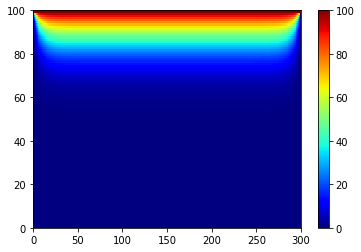

In [ ]:
plt.pcolormesh(T[0], cmap='jet')
plt.colorbar();

In [ ]:
hv.Image(np.array(T[0])[::-1], bounds=(0, 0, L, H)).opts(width=800, height=400, cmap='jet', colorbar=True)

:Image   [x,y]   (z)

### Numpy версия

In [ ]:
def diffuse_step_numpy(ti, T):
    ti = ti % 2
    tj = (ti + 1) % 2
    g = dt * D / dx**2
    T[tj, 1:-1, 1:-1] = T[ti, 1:-1, 1:-1] + \
                        g * (T[ti, 2:,   1:-1] + 
                             T[ti,  :-2, 1:-1] + 
                             T[ti, 1:-1, 2:  ] + 
                             T[ti, 1:-1,  :-2] - 
                             4*T[ti, 1:-1, 1:-1])

In [ ]:
T = np.zeros((2, ny, nx))

# граничные условия
T[:,  0,  :] = 0.0
T[:, -1,  :] = 100.0
T[:,  :,  0] = 0.0
T[:,  :, -1] = 0.0

for i in trange(iterations):
    diffuse_step_numpy(i, T)

100%|██████████████████████████████████████████████████████████████████████████| 40000/40000 [00:04<00:00, 8511.43it/s]


In [ ]:
hv.Image(T[0, ::-1], bounds=(0, 0, L, H)).opts(width=800, height=200, cmap='jet', colorbar=True)

:Image   [x,y]   (z)

### Numexpr версия (медленнее, не нужно рассматривать)

In [ ]:
import numexpr as ne

In [ ]:
def diffuse_step_numexpr(ti, T):
    ti = ti % 2
    tj = (ti + 1) % 2
    g = dt * D / dx**2
    Tti = T[ti, 1:-1, 1:-1]
    Ti_ = T[ti, 2:,   1:-1]
    T_i = T[ti,  :-2, 1:-1]
    Tj_ = T[ti, 1:-1, 2:  ]
    T_j = T[ti, 1:-1,  :-2]
    T[tj, 1:-1, 1:-1] = ne.evaluate("Tti + g * (Ti_ + T_i + Tj_ + T_j - 4*Tti)")

In [ ]:
T = np.zeros((2, ny, nx))

# граничные условия
T[:,  0,  :] = 0.0
T[:, -1,  :] = 100.0
T[:,  :,  0] = 0.0
T[:,  :, -1] = 0.0

for i in trange(iterations):
    diffuse_step_numexpr(i, T)

100%|██████████████████████████████████████████████████████████████████████████| 40000/40000 [00:08<00:00, 4795.69it/s]


In [ ]:
hv.Image(T[0, ::-1], bounds=(0, 0, L, H)).opts(width=800, height=400, cmap='jet', colorbar=True)

:Image   [x,y]   (z)

### Параллельная версия

In [ ]:
Dxy = np.full((ny, nx), D, dtype=float)
mask = (np.arange(nx) // 60) % 2 == 0

k = 10
Dxy[50:90, mask] = D/k
Dxy[50:90, ~mask] = D*k
dt = dx**2 / (4 * Dxy.max())

probes_idx = np.column_stack((np.arange(30, nx, 60), np.full(5, 10)))
probes = probes_idx * dx

pts = hv.Scatter(probes).opts(color='k')
img = hv.Image(Dxy[::-1], bounds=(0, 0, L, H)).opts(logz=True, width=800, height=200, cmap='jet', colorbar=True)

img * pts
#A.nbytes * iterations // 2**30, 'GB'

:Overlay
   .Image.I   :Image   [x,y]   (z)
   .Scatter.I :Scatter   [x]   (y)

In [ ]:
from numba import njit, prange

@njit(parallel=True)
def diffuse_step_par(ti, T, Dxy):
    ti = ti % 2
    tj = (ti + 1) % 2
    for j in prange(1, nx-1):  # y
        for i in range(1, ny-1):  # x
            g = dt * Dxy[i, j] / dx**2
            T[tj, i, j] = T[ti, i, j] + \
                          g * (T[ti, i+1, j] + 
                               T[ti, i-1, j] + 
                               T[ti, i, j+1] + 
                               T[ti, i, j-1] - 
                               4*T[ti, i, j])

@njit
def isolated_boundary_conditions(ti, T):
    tj = ti % 2
    #T[tj, 0, :] = T[tj, 1, :]
    T[tj, :, 0] = T[tj, :, 1]
    #T[tj, -1, :] = T[tj, -2, :]
    T[tj, :, -1] = T[tj, :, -2]
    
# @njit
# def diffuse_steps(n, T):
#     for i in range(n):
#         diffuse_step_par(i, T, A)
#         isolated_boundary_conditions(i, T)



### Визуализация

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
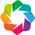

In [ ]:
import holoviews as hv
hv.extension('bokeh')

In [ ]:
def heatmap(data):
    return hv.Image(T[0,::-1], bounds=(0, 0, L, H)).opts(width=800, height=200, cmap='plasma', colorbar=True)

In [ ]:
from holoviews.operation.datashader import datashade, rasterize

In [ ]:
pipe = hv.streams.Pipe()

dmap = hv.DynamicMap(heatmap, streams=[pipe]).opts(tools = ['hover']).redim.range(z=(0., 100.))


#(rasterize(dmap) + datashade(dmap, cmap='jet').opts(width=800, height=200, tools = ['hover'])).cols(1)
dmap

:DynamicMap   []
   :Image   [x,y]   (z)

In [ ]:
T[0][probes_idx[:,1], probes_idx[:, 0]]

array([55.96639295, 61.46671434, 61.58456519, 61.41839746, 55.88486677])

In [ ]:
T = np.zeros((2, ny, nx))
values = []

max_time = 1.0
iterations = int(max_time / dt)

# граничные условия
T[:,  0,  :] = 0.0
T[:, -1,  :] = 100.0
T[:,  :,  0] = 0.0
T[:,  :, -1] = 0.0

chunk = 10000
# for i in trange(iterations // chunk):
#     diffuse_steps(chunk, T)
#     pipe.send({'data':0})
    
for i in trange(iterations):
    diffuse_step_par(i, T, Dxy)
    isolated_boundary_conditions(i, T)
    values.append(T[0][probes_idx[:,1], probes_idx[:, 0]])
    if i % chunk == 0:
        pipe.send({'data':0})


100%|███████████████████████████████████████████████████████████████████████| 399999/399999 [00:13<00:00, 28711.83it/s]


In [ ]:
values = np.array(values)

In [ ]:
hv.Curve({'x':np.arange(iterations)*dt, 'y':values[:, 0]}).opts(width=800, color='r') * \
hv.Curve({'x':np.arange(iterations)*dt, 'y':values[:, 1]}).opts(width=800, color='b')

:Overlay
   .Curve.I  :Curve   [x]   (y)
   .Curve.II :Curve   [x]   (y)